# This notebook is for the Testing of Challenge-2
## Group Members: 
                    * Md. Kamrul Hasan
                    * Basel Alayfi
                    * Fakrul Islam Tushar
## Supervisors: 
                    * Xavier Lladó
                    * Arnau Oliver
                    * Kaisar Kushibar
## Brief Description of the Challenge-2
In this challenge, multi-class image classifier has to be design that will able to classify the given Test images into three class namely, Melanoma (mel), Pigmented Benign Keratosis (bkl) and Basal Cell Carcinoma (bcc). 
### Melanoma (mel): 
The most dangerous form of skin cancer and these cancerous growths develop when unrepaired DNA damage to skin cells triggers mutations (genetic defects) that lead the skin cells to multiply rapidly and form malignant tumors.
### Pigmented Benign Keratosis (bkl):
Pigmented Benign Keratosis is a non-cancerous (benign) skin tumour that originates from cells in the outer layer of the skin.
### Basal Cell Carcinoma (bcc):
Basal cell and squamous cell carcinomas, the two most common forms of skin cancer, are highly curable if detected early and treated properly.

## Objectives and Frameworks
To design design the classifier, transfer learning approches of the Deep Learning (DL) has been adopted due to having less numbers of Training images. As well as, to obtained more robust and accurate results, ensemble of the CNN also has been implemented. The overall results with different analysis has been added to this notebook. 

## Load All the libraries and packages 

In [1]:
from collections import defaultdict
import os
import glob
import random
import sys
import time
import matplotlib.pyplot as plt
import keras
import numpy as np
import cv2
from sklearn.metrics import confusion_matrix
import itertools
from keras.preprocessing import image
from sklearn.metrics import accuracy_score
from keras.callbacks import ModelCheckpoint
from keras.models import model_from_yaml
from keras.layers import Input, Average
from keras.layers.core import Dense, Flatten, Dropout
from keras.layers.merge import Concatenate
from keras.layers.normalization import BatchNormalization
from keras.layers.pooling import GlobalAveragePooling2D, GlobalMaxPooling2D
from keras.applications.vgg16 import VGG16, preprocess_input
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.models import Model
from matplotlib import pyplot as plt
from sklearn.metrics import roc_curve, auc
from scipy import interp
from sklearn.metrics import classification_report
import sklearn
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.utils.fixes import signature
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
# Which GPU is being Used
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [3]:
# Fixation of the GPU usages. Max. it will use 25 %.
import tensorflow as tf
from keras import backend as k
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
config.gpu_options.per_process_gpu_memory_fraction = 0.23
k.tensorflow_backend.set_session(tf.Session(config=config))

## Performance Evaluation Helper Function

In [4]:
def Performance_helper(true_class,pred):
    #............................................................Description of this Helper Function.................................................................................
    
    # This function will take True calss label from the Image Test Generator and Predicted Label from the CNN classifier.
    
    # Objectives of the Function are given below--
    
    # 1. This will plot ROC curve with the AUC values
    # 2. Normalized Confusion Matrix
    # 3. Classification Report for the Classifier 
    # 4. Average Precision Score 
    # 5. Precision VS Recal Curve 
    
    #..............................................................................................................................................................................................
    
    #---------------------------------------ROC and AUC----------------------------------------------
    num_classes=3  # Number of Class which is number of output Neuron. In this example it is 3 which are {'bkl': 1, 'mel': 2, 'bcc': 0}.
    true_classes=keras.utils.to_categorical(true_class, num_classes=num_classes)
    
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    
    for i in range(num_classes):
        fpr[i], tpr[i], _ = roc_curve(true_classes[:, i], pred[:, i]) # Getting TPR and FPR for different threshold using sklearn Function roc_curve. 
        roc_auc[i] = auc(fpr[i], tpr[i])        # Sklean function auc will return Area Under the ROC curve value using previous TPR and FPR.
    
    # First aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(num_classes)]))

    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(num_classes):
        mean_tpr += interp(all_fpr, fpr[i], tpr[i])
        
    # Finally average it and compute AUC.
    mean_tpr /= num_classes
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
    
    # Define the figures and plot the ROC curve. To plot the ROC curve matplotlib has been used. 
    plt.figure()
    plt.plot(fpr["macro"], tpr["macro"], label='Macro-avg ROC with AUC = {0:0.2f}'
                   ''.format(roc_auc["macro"]),
             color='navy', linestyle='-', linewidth=2)
    plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier with AUC = 0.5 ',lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.grid('on')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Macro Average ROC curve')
    plt.legend(loc="lower right")
    plt.show()
    
    #--------------------------------------ConfusionMatrix----------------------------------------
    predicted_classes = np.argmax(pred,axis=1) # Assing the class label either Lesion or Nevus [{'bkl': 1, 'mel': 2, 'bcc': 0}]
    classes=['bcc','bkl','mel']
    title='Normalized Confusion Matrix'
    cmap=plt.cm.Blues
    cm = confusion_matrix(true_class, predicted_classes)
    
#     cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] # Normalizing the TP, FP, FN and TN in Confusion Matrix
    
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' 
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    
    
    #--------------------------------------------Precision VS Recal Analysis---------------------------------------------------
    # For each class
    precision = dict()
    recall = dict()
    average_precision = dict()      
    x = np.float32(true_classes)
    for i in range(num_classes):
        precision[i], recall[i], _ = precision_recall_curve(true_classes[:, i], pred[:, i])
        average_precision[i] = average_precision_score(x[:, i], pred[:, i])

    step_kwargs = ({'step': 'post'}
               if 'step' in signature(plt.fill_between).parameters
               else {})
    # A "micro-average": quantifying score on all classes jointly
    precision["micro"], recall["micro"], _ = precision_recall_curve(true_classes.ravel(), pred.ravel())
    average_precision["micro"] = average_precision_score(true_classes, pred, average="micro")
#     print('Average precision score (micro-averaged over all classes): {0:0.2f}'.format(average_precision["micro"]))
    target_names=['class: bcc', 'class: bkl', 'class: mel']
    ClassificationReport=classification_report(true_class, predicted_classes, target_names=target_names)
    print(ClassificationReport)
    
    plt.figure()
    plt.step(recall['micro'], precision['micro'], color='b', alpha=0.2,where='post')
    plt.fill_between(recall["micro"], precision["micro"], alpha=0.2, color='b',**step_kwargs)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision VS Recall Curve')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('Average precision score, micro-averaged over all classes: AP={0:0.2f}'.format(average_precision["micro"]))
    

## Helper Function for the Wrongly Classified Images

In [5]:
def WrongClassifiedImages(Test_generator, pred_vgg16, ImageDir):
    #............................................................Description of this Helper Function.................................................................................
    
    # This function will take the Image Test Generator, Predicted Label from the CNN classifier and  test Image Directory.
    
    # Objectives of the Function are given below--
    
    # 1. This will print total number of mis-classified Images 
    # 2. It will show all the the mis-classified Images with confidence label
    
    #..............................................................................................................................................................................................
    
    # Get the filenames from the generator
    fnames = Test_generator.filenames

    predicted_classes_VGG16=np.argmax(pred_vgg16,axis=1)

    # Get the label to class mapping from the generator
    label2index = Test_generator.class_indices

    # Getting the mapping from class index to class label
    idx2label = dict((v,k) for k,v in label2index.items())

    errors = np.where(predicted_classes_VGG16 != Test_generator.classes)[0]
    print("No of errors = {}/{}".format(len(errors),Test_generator.samples))


    # Show the errors Images. Here, I am showing all ( len(errors)) the Mis-classified Image. If you want some first specific Numbers, Please, change the Numbers.
    NumberImages=len(errors)
    for i in range(NumberImages):
        pred_class = np.argmax(pred_vgg16[errors[i]])
        # print pred_class.dtype
        pred_label = idx2label[pred_class]
        title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(fnames[errors[i]].split('/')[0], pred_label, pred_vgg16[errors[i]][pred_class])
        original = image.load_img('{}/{}'.format(ImageDir,fnames[errors[i]]))
        plt.figure(figsize=[3,3])
        plt.axis('off')
        plt.title(title)
        plt.imshow(original)
        plt.show()

## Load Image Path and Images

In [6]:
# Loading the Image Path 
ImageDir = '/home/maia_kbf/CADx_3_Class/val'
# print(ImageDir)
MelImagePath=sorted(glob.glob(ImageDir+'/mel/*.jpg'))
bklImagePath=sorted(glob.glob(ImageDir+'/bkl/*.jpg'))
bccImagePath=sorted(glob.glob(ImageDir+'/bcc/*.jpg'))
img=cv2.imread(MelImagePath[0],0)
height, width=img.shape
print('Height='+str(height)+' and Width='+str(width))

Height=450 and Width=600


## Image Generator and Check How Image Generator work

In [7]:
batch_size=2
Test_gen = ImageDataGenerator()
Test_gen = Test_gen.flow_from_directory(
        ImageDir,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)
print(Test_gen.class_indices)
# print(Test_gen.classes)
# print(to_categorical(Test_gen.classes, num_classes=None, dtype='float32'))

Found 500 images belonging to 3 classes.
{'bkl': 1, 'mel': 2, 'bcc': 0}


## Show some images from The Test Images with the corresponding Labels

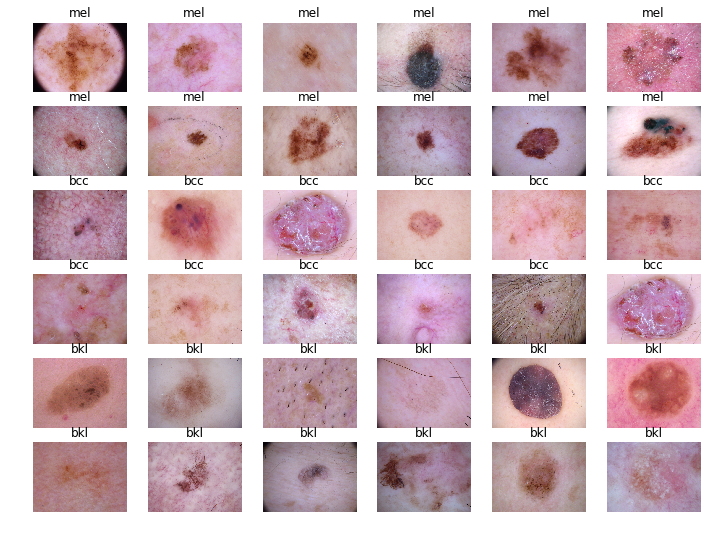

In [8]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

mel=glob.glob(ImageDir+'/mel/*.jpg')
bcc=glob.glob(ImageDir+'/bcc/*.jpg')
bkl=glob.glob(ImageDir+'/bkl/*.jpg')

mel = np.random.choice(mel, 12)
bcc = np.random.choice(bcc, 12)
bkl = np.random.choice(bkl, 12)

data = np.concatenate((mel, bcc,bkl))
labels = 12 * ['mel'] + 12 *['bcc']+12*['bkl']

N, R, C = 36,6,6
plt.figure(figsize=(12, 9))
for k, (src, label) in enumerate(zip(data, labels)):
    im = Image.open(src).convert('RGB')
    plt.subplot(R, C, k+1)
    plt.title(label)
    plt.imshow(np.asarray(im))
    plt.axis('off')

## Performances for the VGG16 Training and Validation, Exp1
In this experiments, two stages of the training have been performed. In the first stage, all the layers of VGG16 has been frozen and training has been done after VGG16 base layers. In the 2nd stage, training has been done after fourth block of VGG16 including fifth block of the VGG16. This experiment has been done without class weight. And No Pre-processing has been used from the keras VGG16 pre-process function.
### Hyper-parameters for stage-1:
Optimizer='rmsprop', loss='categorical_crossentropy', metrics=['accuracy'], Epochs=30. 

### Hyper-parameters for stage-2:
Optimizer=SGD(lr=0.0001, momentum=0.9, nesterov=True),  loss='categorical_crossentropy', metrics=['accuracy'], Epochs=30. 

/home/maia_kbf/virt/local/lib/python2.7/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


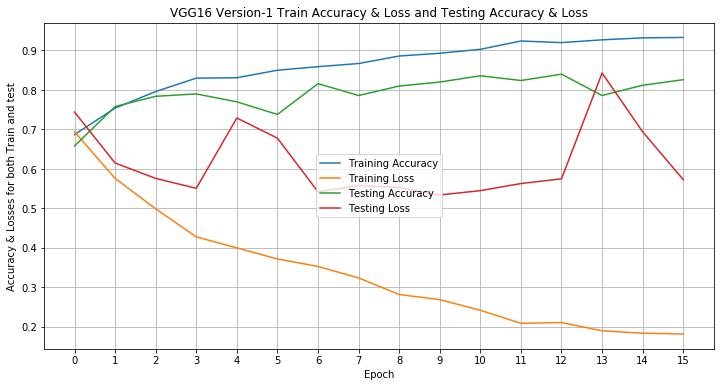

In [9]:
path='VGG16__training.log'

epochs=16
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(path) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 Version-1 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()

## Load VGG16 Model and Measure the Performance

In [10]:
# Load the Model and Trained Model
VGG16Model_V1='VGG16_.yaml'
VGG16Weight_V1='VGG16_.hdf5'

vgg16_V1 = open(VGG16Model_V1, 'r')
vgg_16_V1= vgg16_V1.read()
vgg16_V1.close()

vgg16_MODEL_V1 = model_from_yaml(vgg_16_V1)
vgg16_MODEL_V1.load_weights(VGG16Weight_V1)

# Create The Test Generator for this Classifier 
batch_size=2
Test_generator_V1 = ImageDataGenerator(rescale=1., featurewise_center=True)
Test_generator_V1.mean=np.array([103.939, 116.779, 123.68], dtype=np.float32).reshape(1,1,3)

Test_generator_V1 = Test_generator_V1.flow_from_directory(
        ImageDir,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg16_V1 = vgg16_MODEL_V1.predict_generator(Test_generator_V1,  steps=Test_generator_V1.samples/Test_generator_V1.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 25s 101ms/step


VGG_16 version_1 Accuracy on Test Data is 0.840000


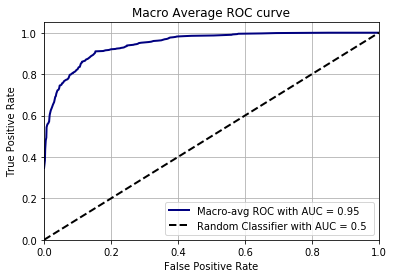

              precision    recall  f1-score   support

  class: bcc       0.96      0.76      0.85       100
  class: bkl       0.84      0.81      0.82       200
  class: mel       0.80      0.91      0.85       200

   micro avg       0.84      0.84      0.84       500
   macro avg       0.87      0.83      0.84       500
weighted avg       0.85      0.84      0.84       500

No of errors = 80/500


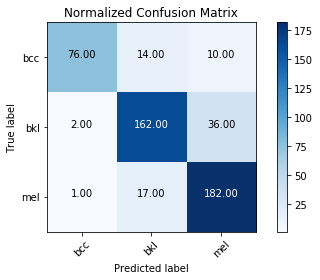

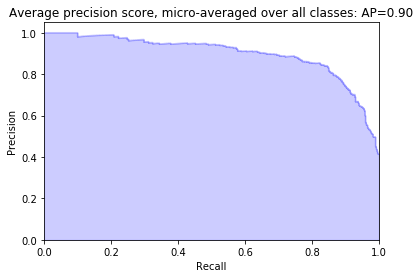

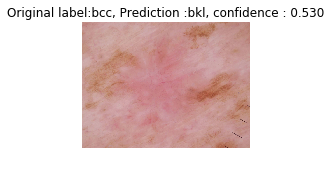

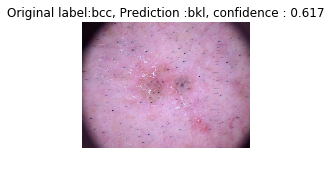

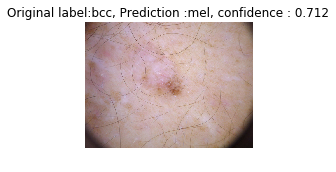

...

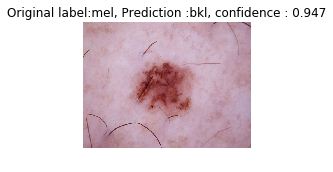

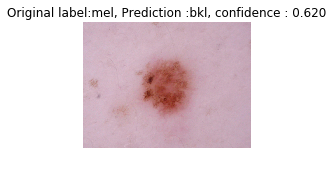

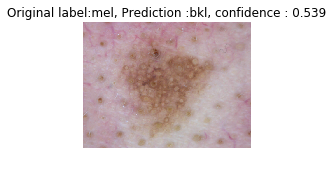

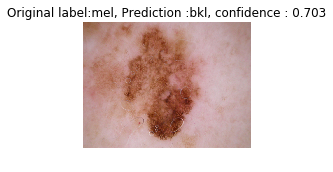

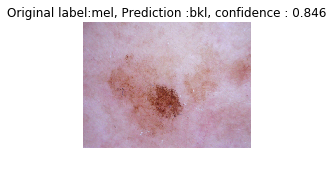

In [11]:
predicted_classes_VGG16_V1 = np.argmax(pred_vgg16_V1,axis=1) # Assing the class label either Lesion or Nevus [{'bkl': 1, 'mel': 2, 'bcc': 0}]

True_class_V1=Test_generator_V1.classes

# print predicted_classes_VGG16
# print true_classes_VGG16

VGG16Accuracy_V1=accuracy_score(True_class_V1, predicted_classes_VGG16_V1)

print('VGG_16 version_1 Accuracy on Test Data is {:f}'.format(VGG16Accuracy_V1))

Performance_helper(True_class_V1, pred_vgg16_V1)  

WrongClassifiedImages(Test_generator_V1, pred_vgg16_V1, ImageDir)

## Performances for the VGG16 Version-2 Training and Validation, Exp2 
This Experiments almost same as the Version-1 Experiments for VGG16. But, here class weight like class_Weight={'bcc': 2, 'bkl': 1, 'mel': 1} has been added as a dictionary in keras fit_generator. Still, there is no pre-processing from Keras.

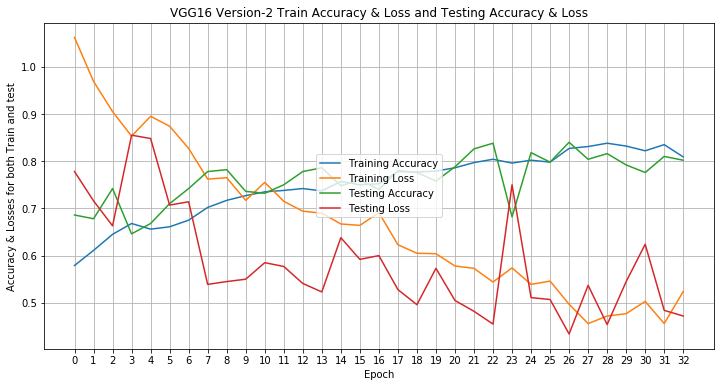

In [12]:
pathVGG='VGG16_V2_Reduced_Param__training.log'

epochs=33
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 Version-2 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


## Load VGG16 Version-2 Model and Measure the Performance

In [13]:
# Load Trained Model and Weight. 
VGG16Model_V2='VGG16_V2_Reduced_Param_.yaml'
VGG16Weight_V2='VGG16_V2_Reduced_Param_.hdf5'

vgg16_V2 = open(VGG16Model_V2, 'r')
vgg_16_V2= vgg16_V2.read()
vgg16_V2.close()

vgg16_MODEL_V2 = model_from_yaml(vgg_16_V2)
vgg16_MODEL_V2.load_weights(VGG16Weight_V2)

# Create The Test Generator for this Classifier 
batch_size=2
Test_generator_V2 = ImageDataGenerator(rescale=1., featurewise_center=True)
Test_generator_V2.mean=np.array([103.939, 116.779, 123.68], dtype=np.float32).reshape(1,1,3)

Test_generator_V2 = Test_generator_V2.flow_from_directory(
        ImageDir,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg16_V2 = vgg16_MODEL_V2.predict_generator(Test_generator_V2,  steps=Test_generator_V2.samples/Test_generator_V2.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 22s 86ms/step


VGG_16 version-2 Accuracy on Test Data is 0.840000


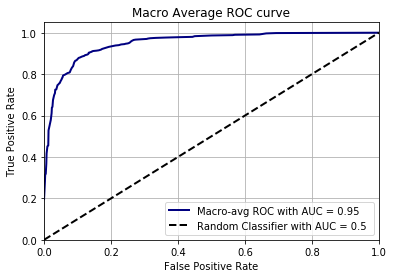

              precision    recall  f1-score   support

  class: bcc       0.86      0.84      0.85       100
  class: bkl       0.83      0.84      0.84       200
  class: mel       0.84      0.83      0.84       200

   micro avg       0.84      0.84      0.84       500
   macro avg       0.84      0.84      0.84       500
weighted avg       0.84      0.84      0.84       500

No of errors = 80/500


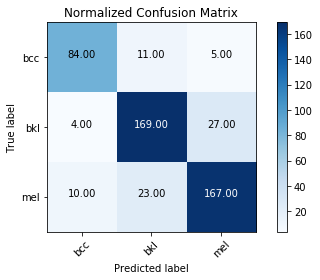

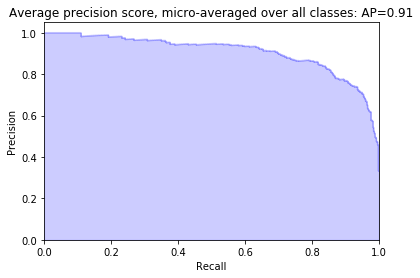

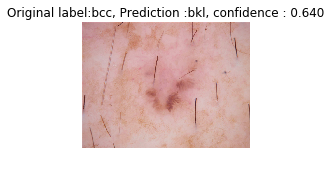

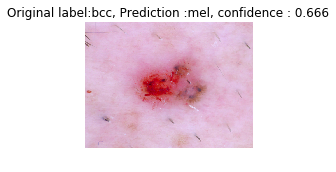

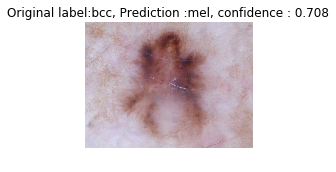

...

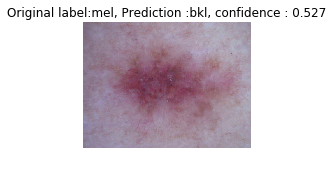

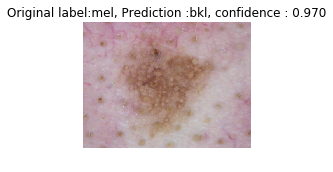

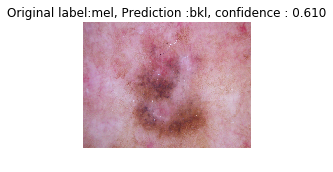

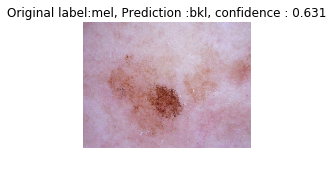

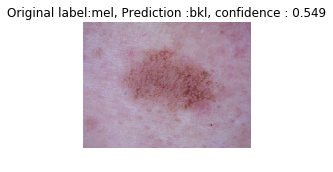

In [14]:
predicted_classes_VGG16_V2 = np.argmax(pred_vgg16_V2,axis=1) # Assing the class label either Lesion or Nevus [{'bkl': 1, 'mel': 2, 'bcc': 0}]

True_class_V2=Test_generator_V2.classes

# print predicted_classes_VGG19
# print true_classes_VGG19

VGG16Accuracy_V2=accuracy_score(True_class_V2, predicted_classes_VGG16_V2)

print('VGG_16 version-2 Accuracy on Test Data is {:f}'.format(VGG16Accuracy_V2))

Performance_helper(True_class_V2 , pred_vgg16_V2)  

WrongClassifiedImages(Test_generator_V2, pred_vgg16_V2, ImageDir)

## Performances for the VGG16 Version-3 Training and Validation, Exp3
This Experiments almost same as the Version-1 and Version-2 Experiments. In this experiment, recaling of image to maximum 1. is replaced by the keras "preprocess_input (from keras.applications.vgg16 import preprocess_input)" function. 

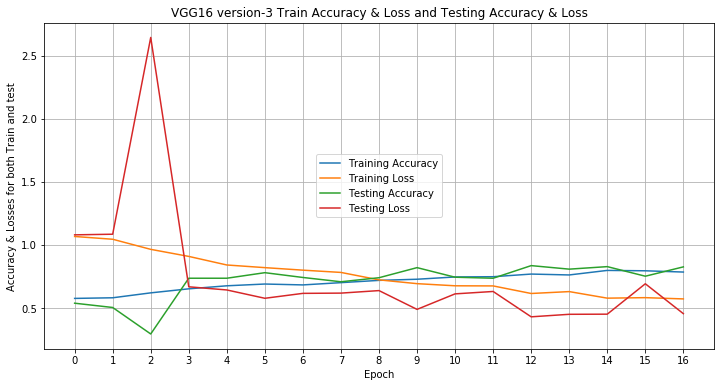

In [15]:
pathVGG='VGG16_V3_Reduced_Param__training.log'

epochs=17
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 version-3 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


## Load VGG16 Version-3 Model and Measure the Performance

In [16]:
VGG16Model_V3='VGG16_V3_Reduced_Param_.yaml'
VGG16Weight_V3='VGG16_V3_Reduced_Param_.hdf5'



vgg16_V3 = open(VGG16Model_V3, 'r')
vgg_16_V3= vgg16_V3.read()
vgg16_V3.close()

vgg16_MODEL_V3 = model_from_yaml(vgg_16_V3)
vgg16_MODEL_V3.load_weights(VGG16Weight_V3)

batch_size=2

# no data augmentation for validation and test set
Test_generator_V3 =ImageDataGenerator(preprocessing_function=preprocess_input, featurewise_center=True)
Test_generator_V3.mean=np.array([103.939, 116.779, 123.68],dtype=np.float32).reshape(1,1,3)

Test_generator_V3 = Test_generator_V3.flow_from_directory(
        ImageDir,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg16_V3 = vgg16_MODEL_V3.predict_generator(Test_generator_V3,  steps=Test_generator_V3.samples/Test_generator_V3.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 26s 105ms/step


VGG_19 Accuracy on Test Data is 0.836000


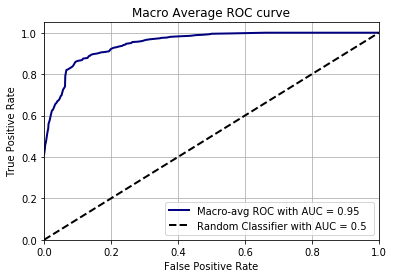

              precision    recall  f1-score   support

  class: bcc       0.88      0.91      0.90       100
  class: bkl       0.87      0.76      0.81       200
  class: mel       0.79      0.88      0.83       200

   micro avg       0.84      0.84      0.84       500
   macro avg       0.85      0.85      0.85       500
weighted avg       0.84      0.84      0.84       500

No of errors = 82/500


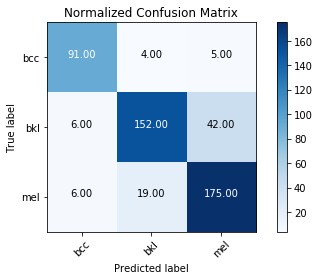

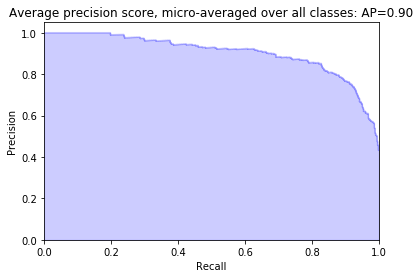

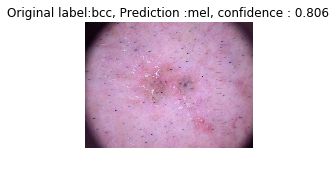

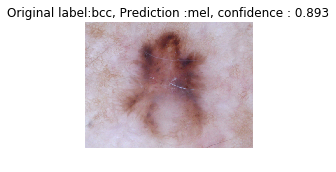

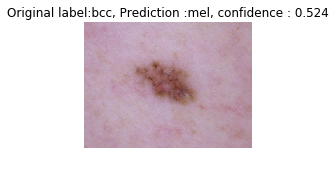

...

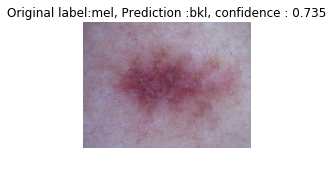

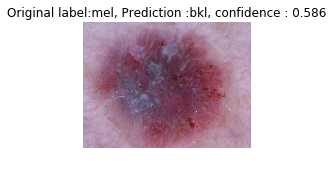

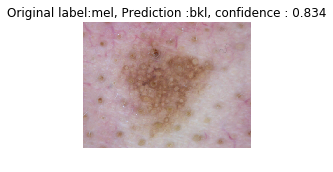

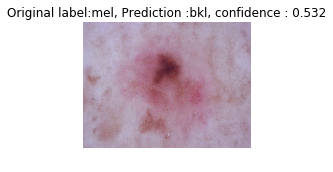

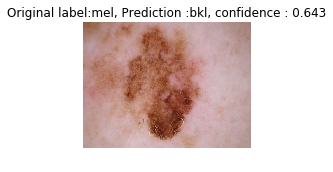

In [17]:
predicted_classes_VGG16_V3 = np.argmax(pred_vgg16_V3, axis=1)

True_class_V3=Test_generator_V3.classes

VGG16Accuracy_V3=accuracy_score(True_class_V3, predicted_classes_VGG16_V3)

print('VGG_19 Accuracy on Test Data is {:f}'.format(VGG16Accuracy_V3))

Performance_helper(True_class_V3 , pred_vgg16_V3)  

WrongClassifiedImages(Test_generator_V3, pred_vgg16_V3, ImageDir)

## Performances for the VGG19 Version-1 Training and Validation using Segmented Images, Exp4
This experiments uses the segmented Images to train and validation. All the hyper-parameters same as the VGG-16 but having more numbers of parameters. The is keras pre-processing. To test this model, test images should be segemenetd. 

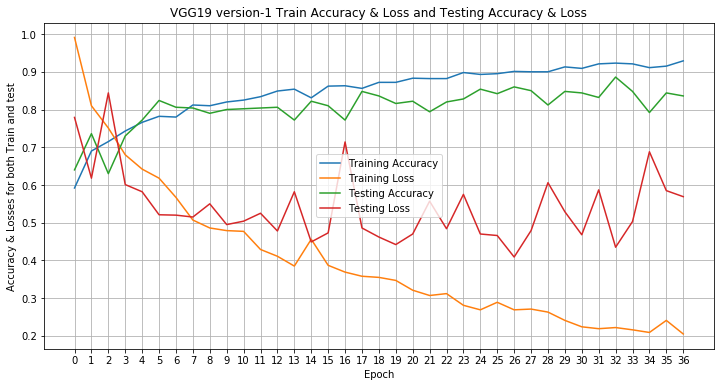

In [18]:
pathVGG='ROI_VGG19_V1_training.log'

epochs=37
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG19 version-1 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


## Load VGG19 Version-1 Model and Measure the Performance

In [19]:
VGG19Model_V1='ROI_VGG19_V1.yaml'
VGG19Weight_V1='ROI_VGG19_V1.hdf5'



vgg19_V1 = open(VGG19Model_V1, 'r')
vgg_19_V1= vgg19_V1.read()
vgg19_V1.close()

vgg19_MODEL_V1 = model_from_yaml(vgg_19_V1)
vgg19_MODEL_V1.load_weights(VGG19Weight_V1)

batch_size=2

ImageDir_Seg='/home/maia_kbf/CADx_3_Class/ROI/val'

# no data augmentation for validation and test set
Test_generator_V4 =ImageDataGenerator(preprocessing_function=preprocess_input)


Test_generator_V4 = Test_generator_V4.flow_from_directory(
        ImageDir_Seg,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg19_V1 = vgg19_MODEL_V1.predict_generator(Test_generator_V4,  steps=Test_generator_V4.samples/Test_generator_V4.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 22s 89ms/step


VGG_19 version-1 Accuracy on Test Data is 0.886000


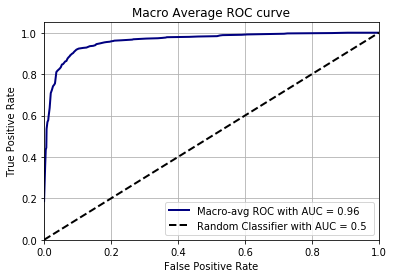

              precision    recall  f1-score   support

  class: bcc       0.95      0.92      0.93       100
  class: bkl       0.86      0.87      0.87       200
  class: mel       0.88      0.89      0.88       200

   micro avg       0.89      0.89      0.89       500
   macro avg       0.90      0.89      0.89       500
weighted avg       0.89      0.89      0.89       500

No of errors = 57/500


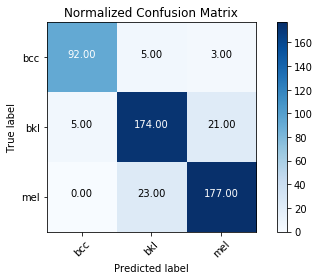

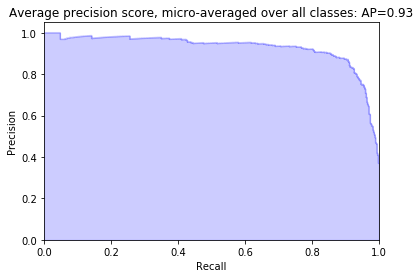

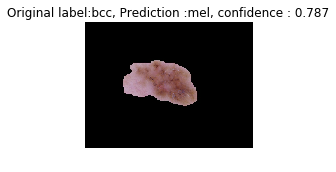

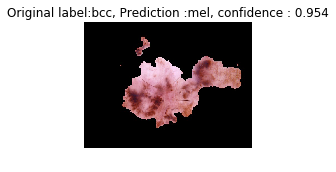

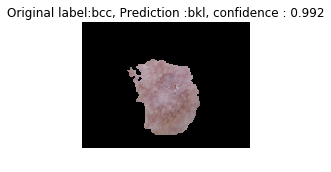

...

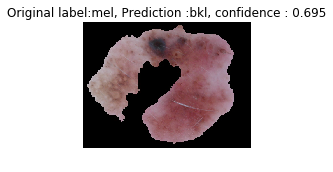

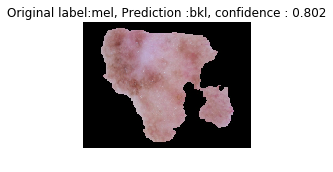

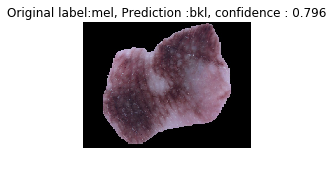

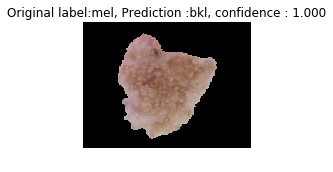

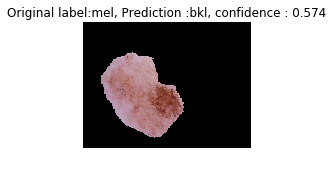

In [20]:
predicted_classes_VGG19_V1 = np.argmax(pred_vgg19_V1, axis=1)

True_class_V4=Test_generator_V4.classes

VGG19Accuracy_V1=accuracy_score(True_class_V4, predicted_classes_VGG19_V1)

print('VGG_19 version-1 Accuracy on Test Data is {:f}'.format(VGG19Accuracy_V1))

Performance_helper(True_class_V4 , pred_vgg19_V1)  

WrongClassifiedImages(Test_generator_V4, pred_vgg19_V1, ImageDir_Seg)

## Performances for the VGG19 Version-2 Training and Validation, Exp5
This Experiment is same as the Version-1 of VGG16 but original Images without segemeneted image original images have been used. The keras "preprocess_input (from keras.applications.vgg16 import preprocess_input)" function also been used.  

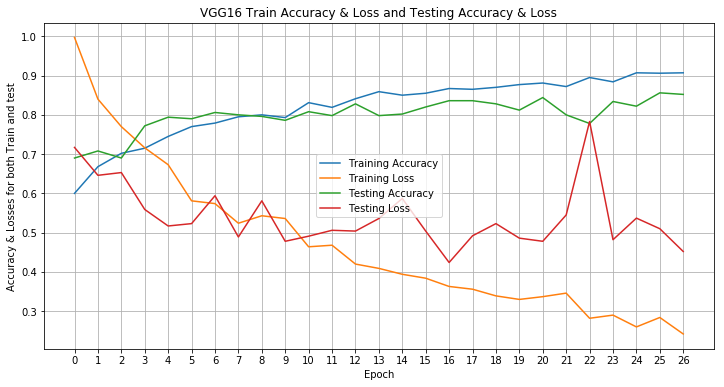

In [21]:
pathVGG='VGG19_Final_training.log'

epochs=27
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


## Load VGG19 Version-2 Model and Measure the Performance

In [22]:
VGG19Model_V2='VGG19_Final.yaml'
VGG19Weight_V2='VGG19_Final.hdf5'



vgg19_V2 = open(VGG19Model_V2, 'r')
vgg_19_V2= vgg19_V2.read()
vgg19_V2.close()

vgg19_MODEL_V2 = model_from_yaml(vgg_19_V2)
vgg19_MODEL_V2.load_weights(VGG19Weight_V2)

batch_size=2
ImageDir_V2='/home/maia_kbf/CADx_3_Class/val'

# no data augmentation for validation and test set
Test_generator_V5 =ImageDataGenerator(preprocessing_function=preprocess_input)
Test_generator_V5.mean=np.array([103.939, 116.779, 123.68],dtype=np.float32).reshape(1,1,3)

Test_generator_V5 = Test_generator_V5.flow_from_directory(
        ImageDir_V2,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg19_V2 = vgg19_MODEL_V2.predict_generator(Test_generator_V5,  steps=Test_generator_V5.samples/Test_generator_V5.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 22s 88ms/step


VGG_19 Accuracy on Test Data is 0.856000


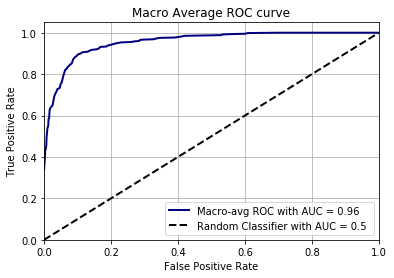

              precision    recall  f1-score   support

  class: bcc       0.95      0.78      0.86       100
  class: bkl       0.82      0.86      0.84       200
  class: mel       0.85      0.89      0.87       200

   micro avg       0.86      0.86      0.86       500
   macro avg       0.88      0.84      0.86       500
weighted avg       0.86      0.86      0.86       500

No of errors = 72/500


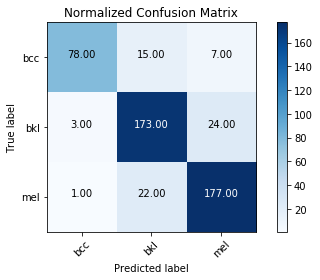

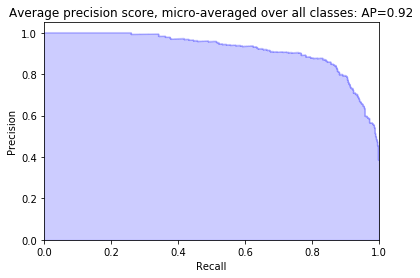

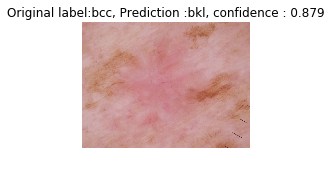

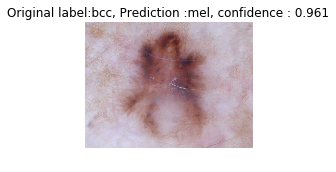

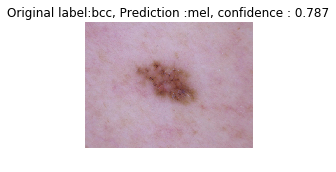

...

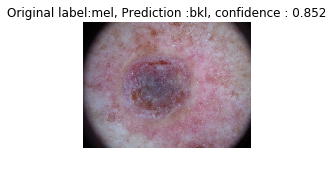

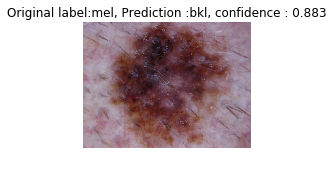

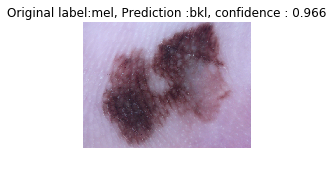

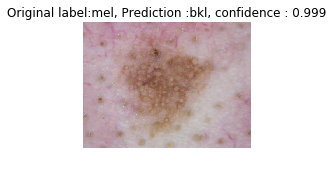

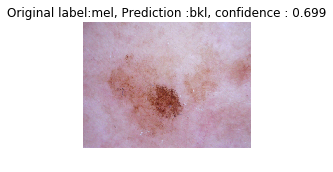

In [23]:
predicted_classes_VGG19_V2 = np.argmax(pred_vgg19_V2, axis=1)

True_class_V5=Test_generator_V5.classes

VGG19Accuracy_V2=accuracy_score(True_class_V5, predicted_classes_VGG19_V2)

print('VGG_19 Accuracy on Test Data is {:f}'.format(VGG19Accuracy_V2))

Performance_helper(True_class_V5 , pred_vgg19_V2)  

WrongClassifiedImages(Test_generator_V5, pred_vgg19_V2, ImageDir_V2)

## Performances for the VGG19 Version-3 Training and Validation, Exp6
In this experiment, all the original Images along with segmenented Images are used. In the segmenteation, only red and green channels has been segmented and merge with blue channel. Network firstly trained with segmented images then trained with original Image. 

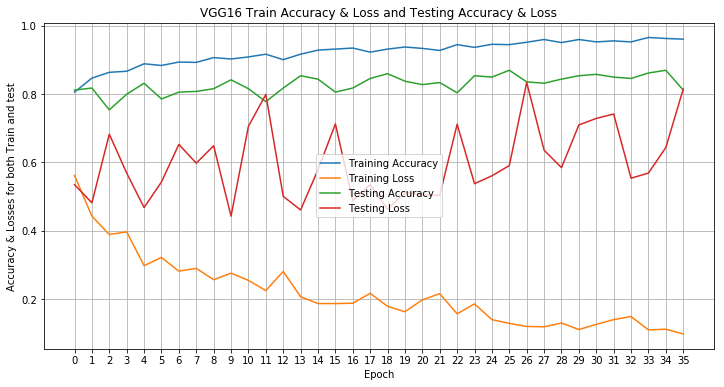

In [24]:
pathVGG='Final_Masked_V3_training.log'

epochs=36
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


In [25]:
# Load trained model along with weight. 
VGG19Model_V3='Final_Masked_V3.yaml'
VGG19Weight_V3='Final_Masked_V3.hdf5'

vgg19_V3 = open(VGG19Model_V3, 'r')
vgg_19_V3= vgg19_V3.read()
vgg19_V3.close()

vgg19_MODEL_V3 = model_from_yaml(vgg_19_V3)
vgg19_MODEL_V3.load_weights(VGG19Weight_V3)

batch_size=2
ImageDir_V2='/home/maia_kbf/CADx_3_Class/val'

# no data augmentation for validation and test set
Test_generator_V6 =ImageDataGenerator(preprocessing_function=preprocess_input)
Test_generator_V6.mean=np.array([103.939, 116.779, 123.68],dtype=np.float32).reshape(1,1,3)

Test_generator_V6 = Test_generator_V6.flow_from_directory(
        ImageDir_V2,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg19_V3 = vgg19_MODEL_V3.predict_generator(Test_generator_V6,  steps=Test_generator_V6.samples/Test_generator_V6.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 20s 82ms/step


VGG_19 Accuracy on Test Data is 0.870000


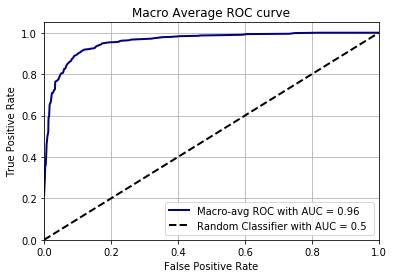

              precision    recall  f1-score   support

  class: bcc       0.94      0.80      0.86       100
  class: bkl       0.86      0.87      0.86       200
  class: mel       0.85      0.91      0.88       200

   micro avg       0.87      0.87      0.87       500
   macro avg       0.88      0.86      0.87       500
weighted avg       0.87      0.87      0.87       500

No of errors = 65/500


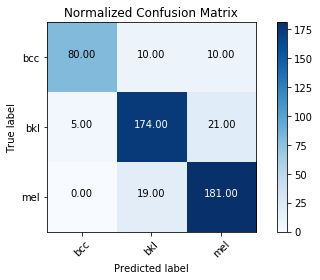

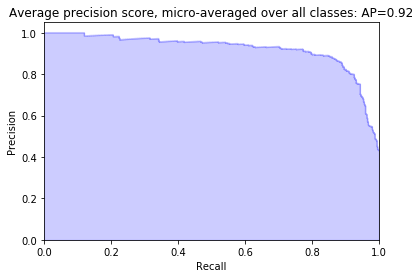

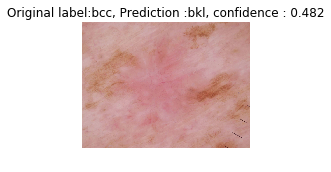

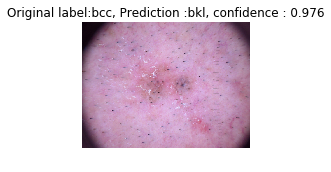

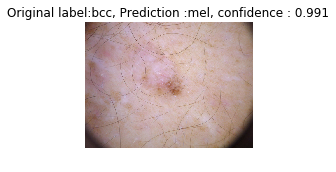

...

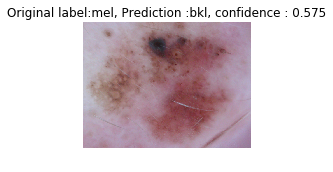

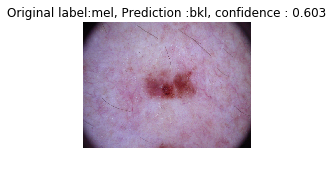

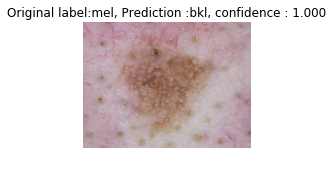

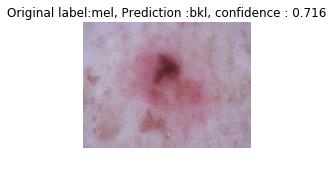

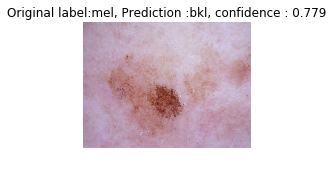

In [26]:
predicted_classes_VGG19_V3 = np.argmax(pred_vgg19_V3, axis=1)

True_class_V6=Test_generator_V6.classes

VGG19Accuracy_V3=accuracy_score(True_class_V6, predicted_classes_VGG19_V3)

print('VGG_19 Accuracy on Test Data is {:f}'.format(VGG19Accuracy_V3))

Performance_helper(True_class_V6 , pred_vgg19_V3)  

WrongClassifiedImages(Test_generator_V6, pred_vgg19_V3, ImageDir_V2)

## Performances for the VGG19 Version-4 Training and Validation, Exp7
In this experiment, all the original Images along with segmenented Images are used. In the segmenteation, all channels has been segmented. Network firstly trained with segmented images then trained with original Image.  

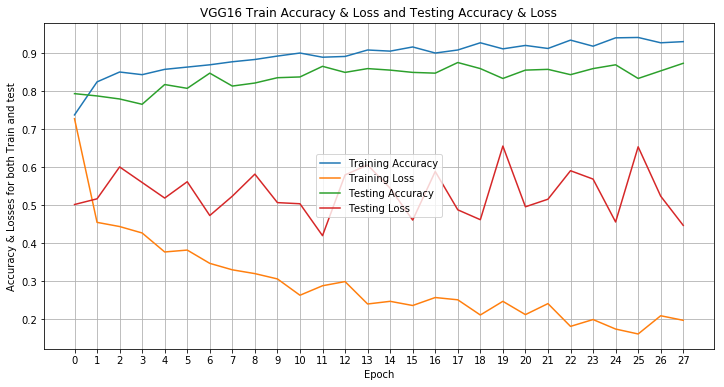

In [27]:
pathVGG='Final_Masked_V2_training.log'

epochs=28
readData=[]
iteration=[]
Tr_acc=[]
Tr_loss=[]
Te_acc=[]
Te_loss=[]

def truncate(f, n):
    return np.floor(f * 10 ** n) / 10 ** n

with open(pathVGG) as f:
    for i in range(epochs+1):
        line = f.readline()
        readData.append(line)
        
for i in range(epochs):
    temp=readData[i+1].split(',')
    iteration.append(temp[0])
    Tr_acc.append(temp[1])
    Tr_loss.append(temp[2])
    Te_acc.append(temp[3])
    Te_loss.append(temp[4])
    
Tr_acc=truncate(np.float_(Tr_acc),3)
Tr_loss=truncate(np.float_(Tr_loss),3)
Te_acc=truncate(np.float_(Te_acc),3)
Te_loss=truncate(np.float_(Te_loss),3)

plt.figure(figsize=(12,6))
plt.plot(iteration,Tr_acc)
plt.plot(iteration,Tr_loss)
plt.plot(iteration,Te_acc)
plt.plot(iteration,Te_loss)

plt.grid('on')
plt.title('VGG16 Train Accuracy & Loss and Testing Accuracy & Loss')
plt.ylabel('Accuracy & Losses for both Train and test')
plt.xlabel('Epoch')
plt.legend(['Training Accuracy', 'Training Loss', 'Testing Accuracy','Testing Loss'], loc='center')
plt.show()


In [28]:
# Load trained model along with weight. 
VGG19Model_V4='Final_Masked_V2.yaml'
VGG19Weight_V4='Final_Masked_V2.hdf5'

vgg19_V4 = open(VGG19Model_V4, 'r')
vgg_19_V4= vgg19_V4.read()
vgg19_V4.close()

vgg19_MODEL_V4 = model_from_yaml(vgg_19_V4)
vgg19_MODEL_V4.load_weights(VGG19Weight_V4)

batch_size=2
ImageDir_V2='/home/maia_kbf/CADx_3_Class/ROI/val'

# no data augmentation for validation and test set
Test_generator_V7 =ImageDataGenerator(preprocessing_function=preprocess_input)
# Test_generator_V7.mean=np.array([103.939, 116.779, 123.68],dtype=np.float32).reshape(1,1,3)

Test_generator_V7 = Test_generator_V7.flow_from_directory(
        ImageDir_V2,
        target_size=(height, width),
        batch_size=batch_size,
        class_mode="categorical",
        shuffle=False)

pred_vgg19_V4 = vgg19_MODEL_V4.predict_generator(Test_generator_V7,  steps=Test_generator_V7.samples/Test_generator_V7.batch_size, verbose=1)


Found 500 images belonging to 3 classes.
250/250 [==============================] - 14s 57ms/step


VGG_19 Accuracy on Test Data is 0.876000


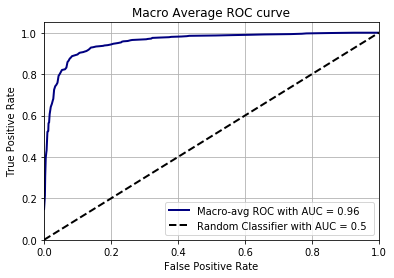

              precision    recall  f1-score   support

  class: bcc       0.91      0.91      0.91       100
  class: bkl       0.86      0.85      0.86       200
  class: mel       0.87      0.89      0.88       200

   micro avg       0.88      0.88      0.88       500
   macro avg       0.88      0.88      0.88       500
weighted avg       0.88      0.88      0.88       500

No of errors = 62/500


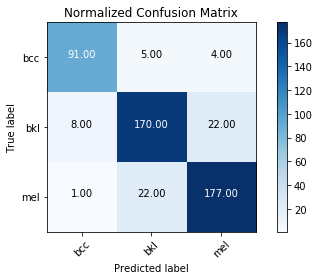

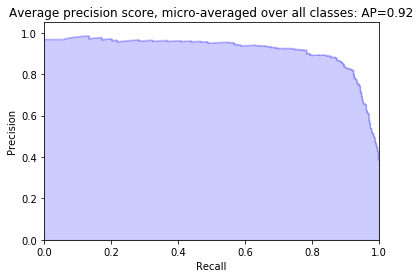

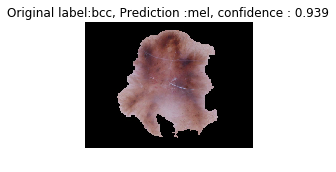

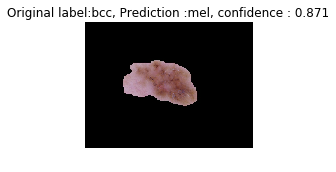

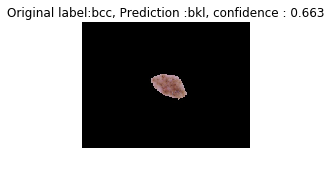

...

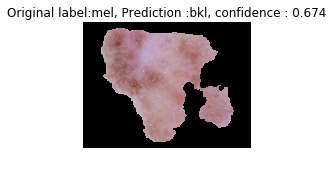

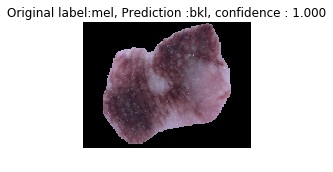

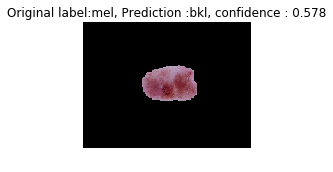

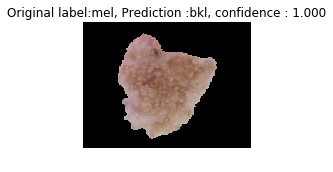

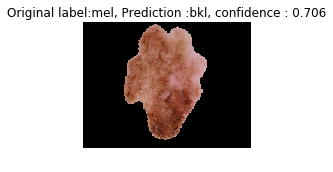

In [29]:
predicted_classes_VGG19_V4 = np.argmax(pred_vgg19_V4, axis=1)

True_class_V7=Test_generator_V7.classes

VGG19Accuracy_V4=accuracy_score(True_class_V7, predicted_classes_VGG19_V4)

print('VGG_19 Accuracy on Test Data is {:f}'.format(VGG19Accuracy_V4))

Performance_helper(True_class_V7 , pred_vgg19_V4)  

WrongClassifiedImages(Test_generator_V7, pred_vgg19_V4, ImageDir_V2)

## Method-1: Ensembled Model Using Soft Voting (Normal Numpy Mean)

Ensemble Accuracy on Test Data is 0.890000


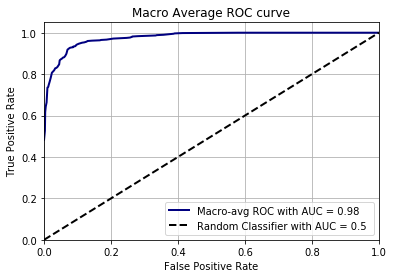

              precision    recall  f1-score   support

  class: bcc       0.98      0.87      0.92       100
  class: bkl       0.89      0.86      0.87       200
  class: mel       0.86      0.93      0.89       200

   micro avg       0.89      0.89      0.89       500
   macro avg       0.91      0.89      0.90       500
weighted avg       0.89      0.89      0.89       500

No of errors = 55/500


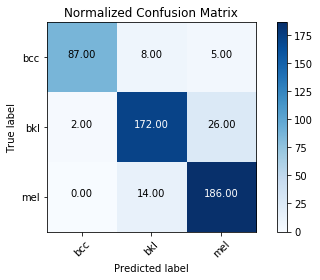

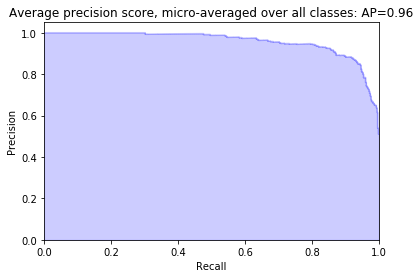

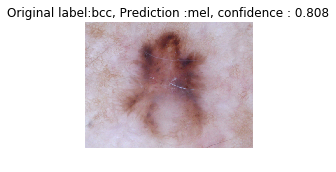

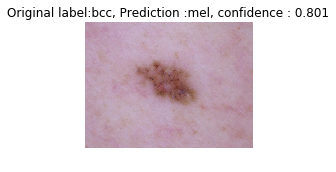

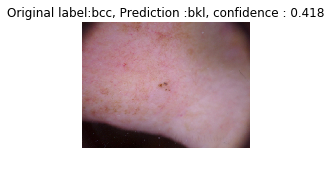

...

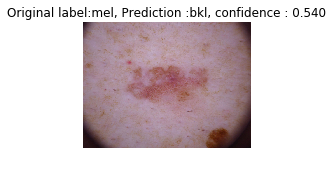

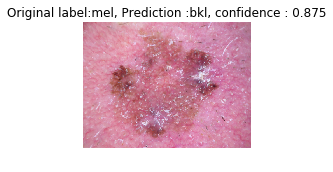

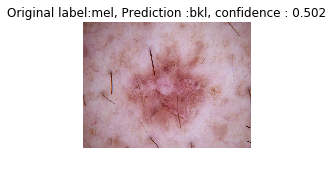

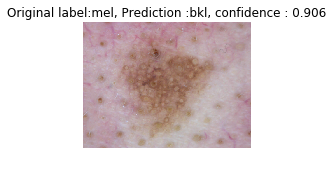

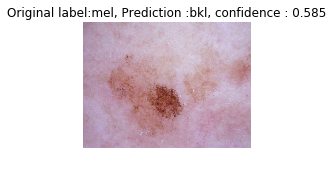

In [30]:
En_Pred=np.mean([pred_vgg16_V1, pred_vgg16_V2, pred_vgg16_V3, pred_vgg19_V1,pred_vgg19_V2,pred_vgg19_V3,pred_vgg19_V4], axis=0)

Accuracy=accuracy_score(True_class_V5,np.argmax(En_Pred,axis=1))

print('Ensemble Accuracy on Test Data is {:f}'.format(Accuracy))

Performance_helper(True_class_V5 , En_Pred)  

WrongClassifiedImages(Test_generator_V5, En_Pred, ImageDir)

## Method-2:  Ensembled Model Using Hard Voting

In [31]:
def hard_vote(votes_matrix, num_classes=3, num_classifiers=4):
    """
    does the voting by counting the votes for each class.
    It is highly recommended to have an odd number of classifers higher than number of classes to assure finding agreeing classifiers. If the number of classifiers is equal to the number of classes, the function might return equal votes for all classes in some cases.
    
    reviewed on 01-Jan-2019
    Parameters
    ----------
    
    votes_matrix : integer list
        the matrix of one-hot votes.
        shape: (N, num_classes, num_classifiers), 
        

    num_classes : integer
        the number of the different classes.

    num_classifiers : integer
        the number of classifiers (votes).

    Returns
    -------

    voting_results : integer list
        shape: N X num_classes.
        the one-hot voting results.

    Example
    -------
    classifier1 = np.array([[1,0],[0,1],[1,0],[1,0]])
    classifier2 = np.array([[1,0],[1,0],[1,0],[1,0]])
    classifier3 = np.array([[0,1],[0,1],[0,1],[1,0]])

    stacked_votes = np.dstack((classifier1, classifier2, classifier3))
    voting_result =  hard_vote(stacked_votes, 2, 3) 
    # output:
    # [[1 0]
    #  [0 1]
    #  [1 0]
    #  [1 0]]
    """
    
    #check number of classifiers
    if(num_classifiers %2 ==0):
        print('warning: it is highly recommended to have an odd number of classifiers to avoid uncertainties')
    
    # check dimensionalities
    if(num_classifiers * num_classes != np.shape(votes_matrix)[1] * np.shape(votes_matrix)[2] ):
        sys.stderr.write('mismatched input shapes and parameters, votes_matrix must have shape (N, num_classes, num_classifiers)')
        sys.exit(0)
        
    
    if(num_classifiers == num_classes):
        print('it is always advised to have more classifiers than classes to avoid uncertainties')

    # add all the votes classifier wise
    votes_sum = np.sum(votes_matrix,axis = 2)

    # the winner is the one who has won the majority (1 and others zeros)
    voting_results  = np.argmax(votes_sum, axis=1)
    
    voting_prob=np.true_divide(votes_sum, num_classifiers)

    return voting_results, voting_prob

Ensemble Accuracy on Test Data is 0.902000


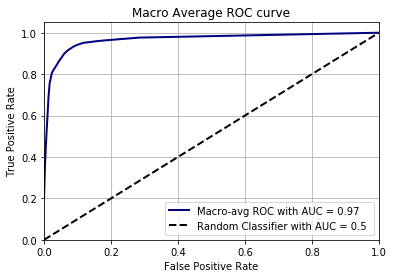

              precision    recall  f1-score   support

  class: bcc       0.98      0.91      0.94       100
  class: bkl       0.90      0.88      0.89       200
  class: mel       0.87      0.93      0.90       200

   micro avg       0.90      0.90      0.90       500
   macro avg       0.92      0.90      0.91       500
weighted avg       0.90      0.90      0.90       500

No of errors = 49/500


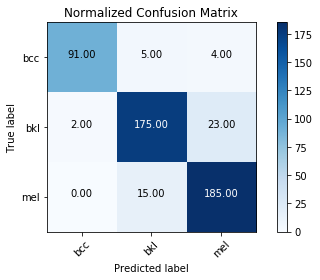

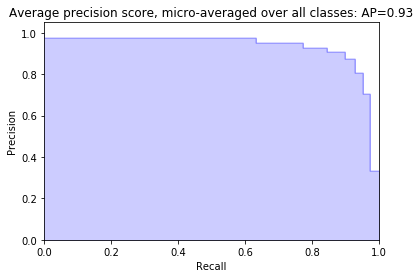

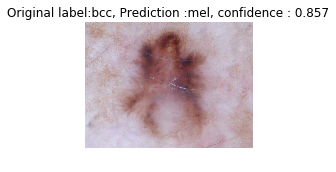

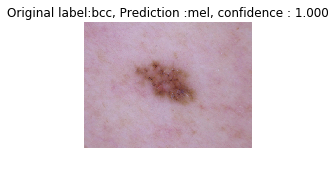

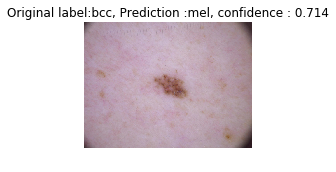

...

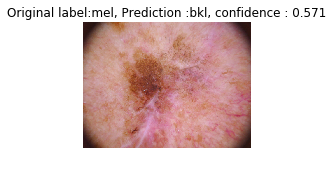

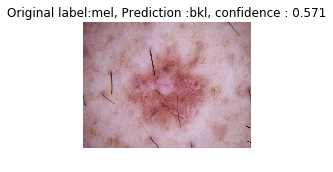

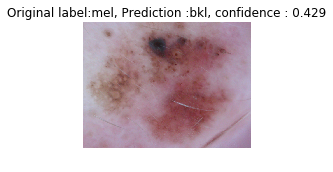

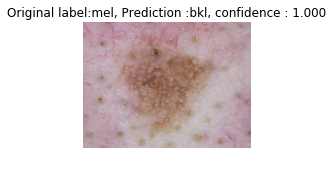

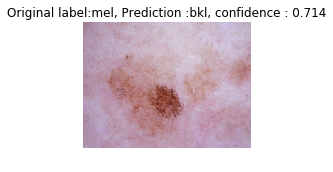

In [32]:
# print(predicted_classes_VGG16)
# print(predicted_classes_VGG19)
# print(predicted_classes_VGG16V3)
# print(to_categorical(predicted_classes_VGG16))
stacked_votes = np.dstack((to_categorical(predicted_classes_VGG16_V1),
                           to_categorical(predicted_classes_VGG16_V2), 
                           to_categorical(predicted_classes_VGG16_V3),
                           to_categorical(predicted_classes_VGG19_V1),
                           to_categorical(predicted_classes_VGG19_V2),
                           to_categorical(predicted_classes_VGG19_V3),
                           to_categorical(predicted_classes_VGG19_V4)
                          ))
_,NumberClass,NumverClassifier=stacked_votes.shape
voting_result, voting_prob =  hard_vote(stacked_votes, NumberClass, NumverClassifier) 
# print(voting_prob)

Accuracy=accuracy_score(True_class_V5, voting_result)

print('Ensemble Accuracy on Test Data is {:f}'.format(Accuracy))

Performance_helper(True_class_V5 , voting_prob)  

WrongClassifiedImages(Test_generator_V5, voting_prob, ImageDir)

## Method-3: Weighted Voting (Depends on AUC of each classifier)

In [33]:
def weighted_vote(confidence_matrix, weights_vec, num_classes=2, num_classifiers=3):
    """
    does a non-democratic voting by comparing the weighted votes for each class.
    It is highly recommended to have an odd number of classifers higher than the number of classes to assure finding agreeing classifiers. 

    Parameters
    ----------
    
    confidence_matrix : float list
        the matrix of confidence values (softmax output).
        shape: (N, num_classes, num_classifiers).
        
    weight_vec : float list
        the vector containing weights for all classifiers. 
        shape : (num_classifiers, 1).

    num_classes : integer
        the number of the different classes.

    num_classifiers : integer
        the number of classifiers (votes).

    Returns
    -------

    voting_results : integer list
        shape: N X 1.
        the assigned label for each sample.

    Example
    -------
    classifier1 = np.array([[.21, 0.3],[0.4, .12],[.81, 0.5],[.17, 0.6]])
    classifier2 = np.array([[.65, 0.1],[.32, 0.9],[0.8, .41],[.15, 0.7]])
    classifier3 = np.array([[0.2, .65],[0.3, .21],[.76, 0.4],[.62, 0.5]])

    aus_vec = [0.9, 0.67, 0.82]
    voting_result =  hard_vote(stacked_votes, auc_vec, 2, 3) 
    # output:[1 1 0 1]
    
    reviewed on 01-Jan-2019
    Modified to include weights on 04-Jan-2019

    author: Basel Alyafi
    """
    
    #check number of classifiers
    if(num_classifiers %2 ==0):
        print('warning: it is highly recommended to have an odd number of classifiers to avoid uncertainties')
    
    # check dimensionalities
    num_samples = np.shape(confidence_matrix)[0]
    if(num_classifiers * num_classes != np.shape(confidence_matrix)[1] * np.shape(confidence_matrix)[2] ):
        raise ValueError('mismatched input shapes and parameters, votes_matrix must have shape (N, num_classes, num_classifiers)')
        
    
    if(num_classifiers <= num_classes):
        print('it is always advised to have more classifiers than classes to avoid uncertainties.')

    if(num_classifiers != np.size(weights_vec)):
        raise ValueError('inappropriate weights_vec size, its size should be equal to num_classifiers.')
        

    # assure that weights_vec has the proper shape 
    weights_vec = np.reshape(weights_vec, (1,np.size(weights_vec)))

    # repeat and reshape the weights_values to have similar dimensions to the confidence matrix
    repeated_weights_vec = np.repeat(weights_vec, num_samples * num_classes, axis=0)

    reshaped_weights_vec = np.reshape(repeated_weights_vec, (num_samples, num_classes, num_classifiers))

    # add all the weighted votes classifier wise
    voting_sum = np.sum(confidence_matrix * reshaped_weights_vec, axis = 2)

    # the winner is the one who has the highest weight
    voting_results = np.argmax(voting_sum, axis=1)
    voting_sum=np.true_divide(voting_sum, num_classifiers)
    return voting_results, voting_sum

Ensemble Accuracy on Test Data is 0.890000


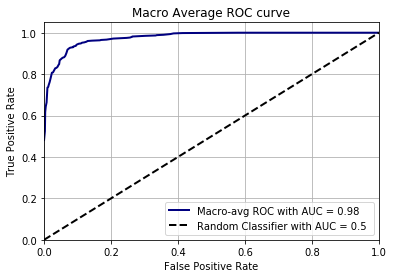

              precision    recall  f1-score   support

  class: bcc       0.98      0.87      0.92       100
  class: bkl       0.89      0.86      0.87       200
  class: mel       0.86      0.93      0.89       200

   micro avg       0.89      0.89      0.89       500
   macro avg       0.91      0.89      0.90       500
weighted avg       0.89      0.89      0.89       500

No of errors = 55/500


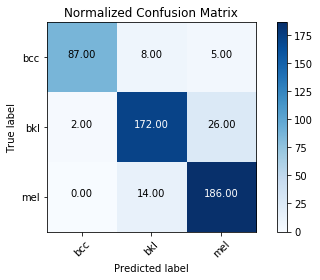

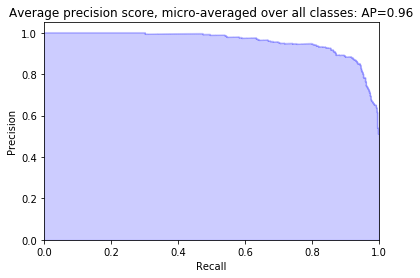

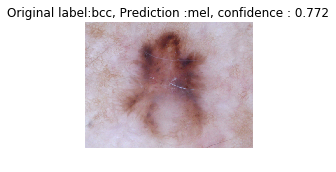

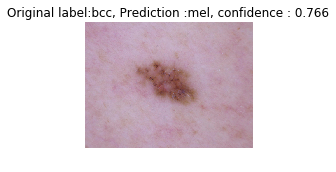

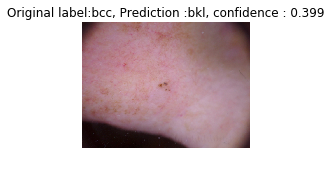

...

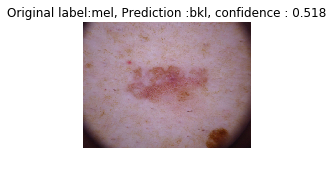

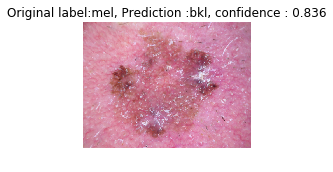

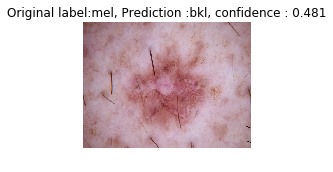

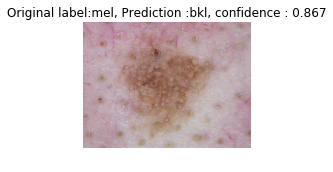

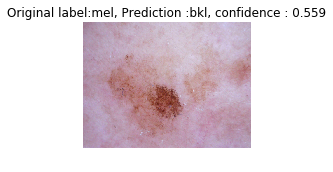

In [34]:
stacked_votes = np.dstack((pred_vgg16_V1, 
                           pred_vgg16_V2, 
                           pred_vgg16_V3, 
                           pred_vgg19_V1,
                           pred_vgg19_V2,
                           pred_vgg19_V3,
                           pred_vgg19_V4
                          ))

_,NumberClass,NumverClassifier=stacked_votes.shape
# print(NumverClassifier)

aus_vec = [0.95,0.95, 0.95, 0.96, 0.96, 0.96, 0.96]
voting_result, voting_prob =  weighted_vote(stacked_votes, aus_vec, NumberClass, NumverClassifier) 

Accuracy=accuracy_score(True_class_V5, voting_result)
print('Ensemble Accuracy on Test Data is {:f}'.format(Accuracy))

Performance_helper(True_class_V5 , voting_prob)  
WrongClassifiedImages(Test_generator_V5, voting_prob, ImageDir)